# Clustering HomoPolymers

In [1]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

c:\Users\ashis\anaconda3\lib\site-packages\numpy\_distributor_init.py:30: UserWarning: loaded more than 1 DLL from .libs:
c:\Users\ashis\anaconda3\lib\site-packages\numpy\.libs\libopenblas.EL2C6PLE4ZYW3ECEVIV3OXXGRN2NRFM2.gfortran-win_amd64.dll
c:\Users\ashis\anaconda3\lib\site-packages\numpy\.libs\libopenblas.XWYDX2IKJW2NMTWSFYNGFUWKQU3LYTCZ.gfortran-win_amd64.dll
  warnings.warn("loaded more than 1 DLL from .libs:"


In [2]:
import sys
sys.path.insert(1, 'y:\\Gihub Repo Work\\Poly_Clust')

import Algorithms.ALG as ALG                   # importing algorithms
import Metrics.GROUND_METRICS as MC_1          # importing lib with Ground metrics - Only for Experimental benchmarking
import Metrics.STANDALONE_METRICS as MC_2      # importing lib with standalone metrics

import Worker.INITIAL_PLOTTER as IPLOT         # Initial Sample plotter
import Worker.FINAL_PLOTTER as FPLOT           # Cluster Sample & result Plotter 

import Worker.DATA_READER as DR                # Data Reader i.e. Path of the scan data

import Worker.MODS as DM                       # Data Operations to be performed 

#### Reading the  AFM Scan  Data

In [3]:
data, original = DR.reader("W:\\Data PYTHON\\SET_1\\COMBINED") # The path of the AFM scan data is entered here

# Data = reshaped data for clustering
# original = AFM scan data in image matrixformat 

#### Data operations 

In [4]:
# Performs 1D & 2D Fourier Transform on the Data


# One Dimensional Fourier Transform (INPUT = Original Part from reader())
# Output = Two elements (Columns) (Rows), We are using ROWS for clustering 

ONE_Data = DM.Process_1D_F(original) #ROW WISE

# Two Dimensional Fourier Transform (INPUT = Original Part from reader())
# Output = One elements Transformed Data of AFM scan in 2D Fourier format

TWO_Data = DM.Process_2D_F(original)

------------

#### Performing Clustering using the various algorithms for three types of data:

        Data 1. RAW AFM data
        Data 2. ONE Dimensional Fourier Transformed Data
        Data 3. TWO Dimensional Fourier Transfomred Data

At this stage of the tool, the aim was to benchmark the algorithms, hence, the algorithms was split into two main groups:

        Group 1. Automated Clustering (These are algorithms that automatically perform clustering via internal calculations)
        Group 2. Parameteric Clustering (These are algorithms that require additional tuning to obtain proper results)



#### The Naming of the Variables is as follows:

    T_ = Type of Data (RAW, ONE D, TWO D) [1,2,3]
    A_ = Algorithm Number [1,13]
    G_ = Groups of Algorithms [1,2]

-----------

#### Data 1: RAW AFM Data

##### Group 1

c:\Users\ashis\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\ashis\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
c:\Users\ashis\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\ashis\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are

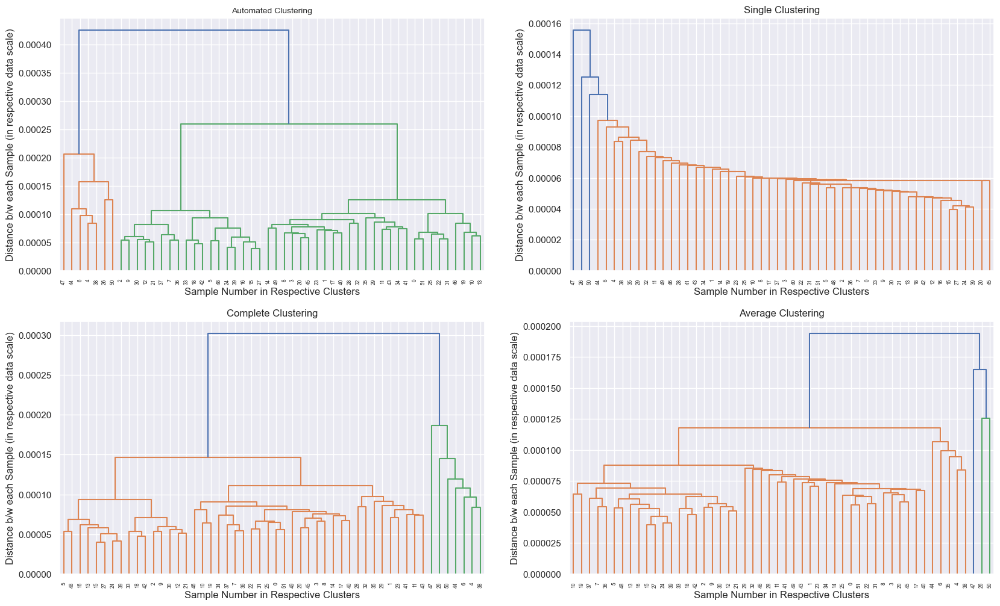

c:\Users\ashis\anaconda3\lib\site-packages\sklearn\cluster\_birch.py:725: ConvergenceWarning: Number of subclusters found (1) by BIRCH is less than (3). Decrease the threshold.
  warnings.warn(


In [5]:
T1_A1_G1 = ALG.K_MEANS(data, 3) 
T1_A2_G1 = ALG.K_MEANS_PLUS(data, 3)
T1_A3_G1 = ALG.K_MEANS_BISECT(data, 3)
T1_A7_G1 = ALG.HIERARCHY(data, 3, 1)
T1_A8_G1 = ALG.FUZZY_C(data, 3)
T1_A11_G1 = ALG.BIRCH(data, 3)
T1_A13_G1 = ALG.SPECTRAL(data, 3)

#### Group 2

In [6]:
T1_A4_G2 = ALG.DBSCAN_AUTO(data, 2,2)
T1_A9_G2 = ALG.MEAN_SHIFT(data,0.00013)
T1_A10_G2 = ALG.AFFINITY(data,0.999)
T1_A5_G2 = ALG.DBSCAN_MANUAL(data,0.00015,3)      #DBSCAN MANUAL
T1_A6_G2 = ALG.HDBSCAN_MANUAL(data,6,3,475) #HDBSCAN_MANUAL
T1_A12_G2 = ALG.OPTICS_AUTO(data, 3)        #OPTICS AUTO

---------------

#### Data 2: ONE Dimensional Fourier Transform

#### Group 1

c:\Users\ashis\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\ashis\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
c:\Users\ashis\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\ashis\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are

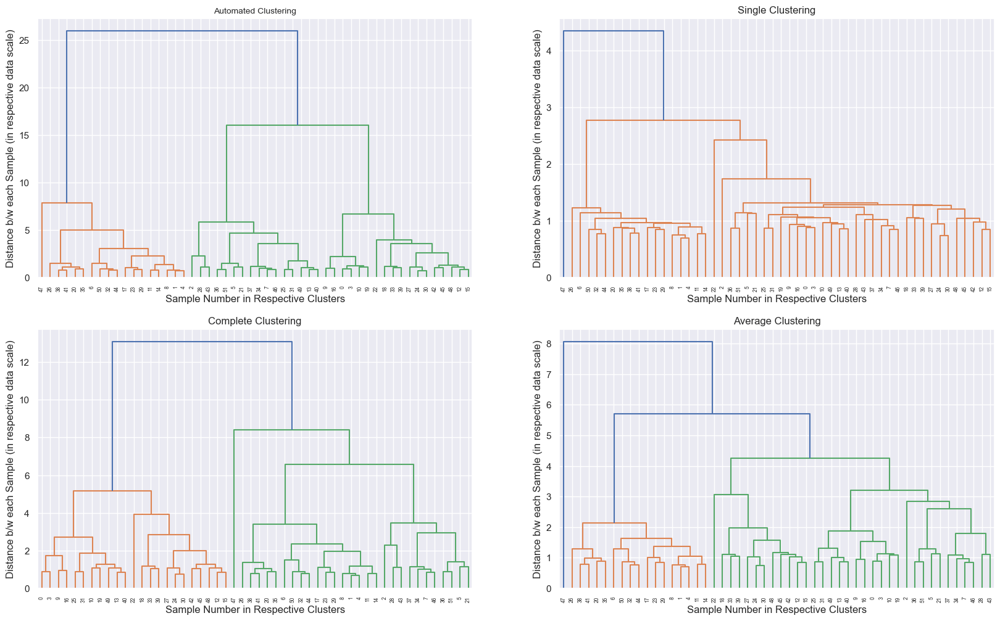

In [6]:
T2_A1_G1 = ALG.K_MEANS(ONE_Data[1], 3) 
T2_A2_G1 = ALG.K_MEANS_PLUS(ONE_Data[1], 3)
T2_A3_G1 = ALG.K_MEANS_BISECT(ONE_Data[1], 3)
T2_A7_G1 = ALG.HIERARCHY(ONE_Data[1], 3, 1)
T2_A8_G1 = ALG.FUZZY_C(ONE_Data[1], 3)
T2_A11_G1 = ALG.BIRCH(ONE_Data[1], 3)
T2_A13_G1 = ALG.SPECTRAL(ONE_Data[1], 3)

#### Group 2

In [8]:
T2_A4_G2 = ALG.DBSCAN_AUTO(ONE_Data[1], 2,2)
T2_A9_G2 = ALG.MEAN_SHIFT(ONE_Data[1], 3)
T2_A10_G2 = ALG.AFFINITY(ONE_Data[1],0.5)

T2_A5_G2 = ALG.DBSCAN_MANUAL(ONE_Data[1],1.29,2)
T2_A6_G2 = ALG.HDBSCAN_MANUAL(ONE_Data[1],6,2,475) #5,3,475) #HDBSCAN_MANUAL
T2_A12_G2 = ALG.OPTICS_AUTO(ONE_Data[1], 8) 

----------

#### Data 3: TWO Dimensional Fourier Transform

#### Group 1

c:\Users\ashis\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\ashis\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(
c:\Users\ashis\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
c:\Users\ashis\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are

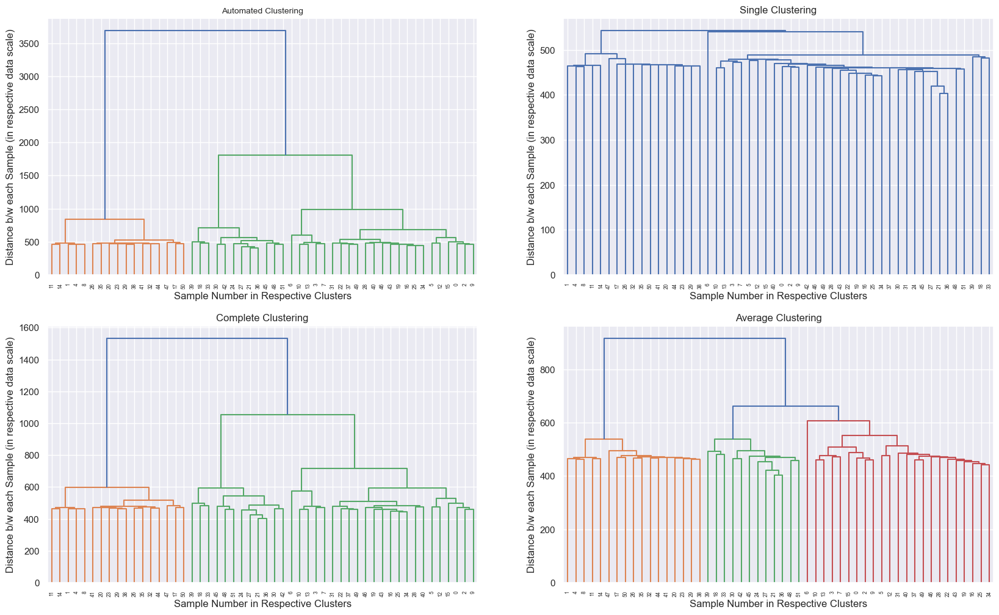

c:\Users\ashis\anaconda3\lib\site-packages\sklearn\manifold\_spectral_embedding.py:273: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  warnings.warn(


In [7]:
T3_A1_G1 = ALG.K_MEANS(TWO_Data, 3) 
T3_A2_G1 = ALG.K_MEANS_PLUS(TWO_Data, 3)
T3_A3_G1 = ALG.K_MEANS_BISECT(TWO_Data, 3)
T3_A7_G1 = ALG.HIERARCHY(TWO_Data, 3,1)
T3_A8_G1 = ALG.FUZZY_C(TWO_Data, 3)
T3_A11_G1 = ALG.BIRCH(TWO_Data, 3)
T3_A13_G1 = ALG.SPECTRAL(TWO_Data, 3)

#### Group 2

In [10]:
T3_A4_G2 = ALG.DBSCAN_AUTO(TWO_Data, 2, 2)
T3_A9_G2 = ALG.MEAN_SHIFT(TWO_Data, 486)
T3_A10_G2 = ALG.AFFINITY(TWO_Data, 0.91)

T3_A5_G2 = ALG.DBSCAN_MANUAL(TWO_Data,477,5)
T3_A6_G2 = ALG.HDBSCAN_MANUAL(TWO_Data,6,4,475)
T3_A12_G2 = ALG.OPTICS_AUTO(TWO_Data, 8)

-----------

#### Creation of Ground truth to Verify the execution of the Metrics

##### Establishing Ground truth

In [11]:
GD = np.array([0, 1, 2, 0, 1, 2, 1, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2,
       0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0, 1, 2, 0,
       1, 2, 0, 1, 2, 0, 1, 2])

## Evaluation of the Results

    1. Ground Truth Metrics:
        1. Rand Index
        2. Adj Rand Index 
        3. MMI
        4. Homogeneity 
        5. Completness
        6. V Measure
        7. Geometric Mean 

    2. Non Ground Truth Metrics:
        1. Silhouette_Score
        2. Calinski_Harabasz_Score
        3. Davies_Bouldin_Score

----------

#### Evaluating Metrics for Data Type 1 (RAW Data)

In [12]:
T1_A1_G1_M1 =  MC_1.Metric_1(GD, T1_A1_G1[1],"K MEANS")
T1_A2_G1_M1 =  MC_1.Metric_1(GD, T1_A2_G1[1],"K MEANS++")
T1_A3_G1_M1 =  MC_1.Metric_1(GD, T1_A3_G1[1],"K MEANS BISECT")
T1_A7_G1_M1 =  MC_1.Metric_1(GD, T1_A7_G1[1],"HIERARCHY")
T1_A8_G1_M1 =  MC_1.Metric_1(GD, T1_A8_G1[1],"FUZZY_C")
T1_A11_G1_M1 =  MC_1.Metric_1(GD, T1_A11_G1[1],"BIRCH")
T1_A13_G1_M1 =  MC_1.Metric_1(GD, T1_A13_G1[1],"SPECTRAL")

T1_A4_G2_M1 =  MC_1.Metric_1(GD, T1_A4_G2[1],"DBSCAN AUTO")
T1_A9_G2_M1 =  MC_1.Metric_1(GD, T1_A9_G2[1],"MEAN SHIFT")
T1_A10_G2_M1 =  MC_1.Metric_1(GD, T1_A10_G2[1],"AFFINITY")

T1_A5_G2_M1 =  MC_1.Metric_1(GD, T1_A5_G2[1],"DBSCAN MANUAL")
T1_A6_G2_M1 =  MC_1.Metric_1(GD, T1_A6_G2[1],"HDBSCAN MANUAL")
T1_A12_G2_M1 =  MC_1.Metric_1(GD, T1_A12_G2[1],"OPTICS AUTO")


T1_Final_1_M1 = pd.concat([T1_A1_G1_M1[1], T1_A2_G1_M1[1], T1_A3_G1_M1[1], T1_A7_G1_M1[1], T1_A8_G1_M1[1], T1_A11_G1_M1[1], T1_A13_G1_M1[1]])
T1_Final_2_M1 = pd.concat([T1_A4_G2_M1[1], T1_A9_G2_M1[1], T1_A10_G2_M1[1]])
T1_Final_3_M1 = pd.concat([T1_A5_G2_M1[1], T1_A6_G2_M1[1], T1_A12_G2_M1[1]]) 

DA_A_G = pd.concat([T1_Final_1_M1,T1_Final_2_M1,T1_Final_3_M1])
DA_A_G.columns = pd.MultiIndex.from_product([[" Ground Truth Metrics "], DA_A_G.columns])
DA_A_G.style.set_table_attributes("style='display:inline'").set_caption('Performance of Algorithms using AFM Height Data via Ground Truth Metrics')



In [13]:
T1_A1_G1_M2 =  MC_2.Metric_2(data, T1_A1_G1[1],"K MEANS")
T1_A2_G1_M2 =  MC_2.Metric_2(data, T1_A2_G1[1],"K MEANS++")
T1_A3_G1_M2 =  MC_2.Metric_2(data, T1_A3_G1[1],"K MEANS BISECT")
T1_A7_G1_M2 =  MC_2.Metric_2(data, T1_A7_G1[1],"HIERARCHY")
T1_A8_G1_M2 =  MC_2.Metric_2(data, T1_A8_G1[1],"FUZZY_C")
#T1_A11_G1_M2 =  MC_2.Metric_2(data, T1_A11_G1[1],"BIRCH")
T1_A13_G1_M2 =  MC_2.Metric_2(data, T1_A13_G1[1],"SPECTRAL")

T1_A4_G2_M2 =  MC_2.Metric_2(data, T1_A4_G2[1],"DBSCAN AUTO")
T1_A9_G2_M2 =  MC_2.Metric_2(data, T1_A9_G2[1],"MEAN SHIFT")
T1_A10_G2_M2 =  MC_2.Metric_2(data, T1_A10_G2[1],"AFFINITY") 

T1_A5_G2_M2 =  MC_2.Metric_2(data, T1_A5_G2[1],"DBSCAN MANUAL")
#T1_A6_G2_M2 =  MC_2.Metric_2(data, (T1_A6_G2[1]+1),"HDBSCAN MANUAL")
T1_A12_G2_M2 =  MC_2.Metric_2(data, T1_A12_G2[1],"OPTICS AUTO")


T1_Final_1_M2 = pd.concat([T1_A1_G1_M2[1], T1_A2_G1_M2[1], T1_A3_G1_M2[1], T1_A7_G1_M2[1], T1_A8_G1_M2[1], T1_A13_G1_M2[1]])#T1_A11_G1_M2[1], 
T1_Final_2_M2 = pd.concat([T1_A4_G2_M2[1], T1_A9_G2_M2[1],T1_A10_G2_M2[1]])
T1_Final_3_M2 = pd.concat([T1_A5_G2_M2[1], T1_A12_G2_M2[1]]) #T1_A6_G2_M2[1],

DA_A_NG = pd.concat([T1_Final_1_M2,T1_Final_2_M2,T1_Final_3_M2])
DA_A_NG.columns = pd.MultiIndex.from_product([["Non-Ground Truth Metrics"], DA_A_NG.columns])
DA_A_NG.style.set_table_attributes("style='display:inline'").set_caption('Performance of Algorithms using 2D Fourier Transformed Data via Ground Truth Metrics')
#SS.style.set_caption("Performance of Algorithms using 2D Fourier Transformed Data via Ground Truth Metrics")

#### Evaluating Metrics for Data Type 2 (ONE Dimensional Fourier Data)

In [14]:
#
T2_A1_G1_M1 =  MC_1.Metric_1(GD, T2_A1_G1[1],"K MEANS")
T2_A2_G1_M1 =  MC_1.Metric_1(GD, T2_A2_G1[1],"K MEANS++")
T2_A3_G1_M1 =  MC_1.Metric_1(GD, T2_A3_G1[1],"K MEANS BISECT")
T2_A7_G1_M1 =  MC_1.Metric_1(GD, T2_A7_G1[1],"HIERARCHY")
T2_A8_G1_M1 =  MC_1.Metric_1(GD, T2_A8_G1[1],"FUZZY_C")
T2_A11_G1_M1 =  MC_1.Metric_1(GD, T2_A11_G1[1],"BIRCH")
T2_A13_G1_M1 =  MC_1.Metric_1(GD, T2_A13_G1[1],"SPECTRAL")

T2_A4_G2_M1 =  MC_1.Metric_1(GD, T2_A4_G2[1],"DBSCAN AUTO")
T2_A9_G2_M1 =  MC_1.Metric_1(GD, T2_A9_G2[1],"MEAN SHIFT")
T2_A10_G2_M1 =  MC_1.Metric_1(GD, T2_A10_G2[1],"AFFINITY")

T2_A5_G2_M1 =  MC_1.Metric_1(GD, T2_A5_G2[1],"DBSCAN MANUAL")
T2_A6_G2_M1 =  MC_1.Metric_1(GD, T2_A6_G2[1],"HDBSCAN MANUAL")
T2_A12_G2_M1 =  MC_1.Metric_1(GD, T2_A12_G2[1],"OPTICS AUTO")


#
T2_Final_1_M1 = pd.concat([T2_A1_G1_M1[1], T2_A2_G1_M1[1], T2_A3_G1_M1[1], T2_A7_G1_M1[1], T2_A8_G1_M1[1], T2_A11_G1_M1[1], T2_A13_G1_M1[1]])
T2_Final_2_M1 = pd.concat([T2_A4_G2_M1[1], T2_A9_G2_M1[1], T2_A10_G2_M1[1]])
T2_Final_3_M1 = pd.concat([T2_A5_G2_M1[1], T2_A6_G2_M1[1], T2_A12_G2_M1[1]]) 


#
DA_B_G = pd.concat([T2_Final_1_M1,T2_Final_2_M1,T2_Final_3_M1])
DA_B_G.columns = pd.MultiIndex.from_product([["Ground Truth Metrics"], DA_B_G.columns])
DA_B_G.style.set_table_attributes("style='display:inline'").set_caption('Performance of Algorithms using 1D Fourier Transformed Data via Ground Truth Metrics')


In [15]:
T2_A1_G1_M2 =  MC_2.Metric_2(ONE_Data[1], T2_A1_G1[1],"K MEANS")
T2_A2_G1_M2 =  MC_2.Metric_2(ONE_Data[1], T2_A2_G1[1],"K MEANS++")
T2_A3_G1_M2 =  MC_2.Metric_2(ONE_Data[1], T2_A3_G1[1],"K MEANS BISECT")
T2_A7_G1_M2 =  MC_2.Metric_2(ONE_Data[1], T2_A7_G1[1],"HIERARCHY")
T2_A8_G1_M2 =  MC_2.Metric_2(ONE_Data[1], T2_A8_G1[1],"FUZZY_C")
T2_A11_G1_M2 =  MC_2.Metric_2(ONE_Data[1], T2_A11_G1[1],"BIRCH")
T2_A13_G1_M2 =  MC_2.Metric_2(ONE_Data[1], T2_A13_G1[1],"SPECTRAL")


#
T2_A4_G2_M2 =  MC_2.Metric_2(ONE_Data[1], T2_A4_G2[1],"DBSCAN AUTO")
T2_A9_G2_M2 =  MC_2.Metric_2(ONE_Data[1], T2_A9_G2[1],"MEAN SHIFT")
T2_A10_G2_M2 =  MC_2.Metric_2(ONE_Data[1], T2_A10_G2[1],"AFFINITY") 

T2_A5_G2_M2 =  MC_2.Metric_2(ONE_Data[1], T2_A5_G2[1],"DBSCAN MANUAL")
T2_A6_G2_M2 =  MC_2.Metric_2(ONE_Data[1], T2_A6_G2[1],"HDBSCAN MANUAL")
T2_A12_G2_M2 =  MC_2.Metric_2(ONE_Data[1], T2_A12_G2[1],"OPTICS AUTO")


#
T2_Final_1_M2 = pd.concat([T2_A1_G1_M2[1], T2_A2_G1_M2[1], T2_A3_G1_M2[1], T2_A7_G1_M2[1], T2_A8_G1_M2[1], T2_A11_G1_M2[1], T2_A13_G1_M2[1]])
T2_Final_2_M2 = pd.concat([T2_A4_G2_M2[1], T2_A9_G2_M2[1],T2_A10_G2_M2[1]])
T2_Final_3_M2 = pd.concat([T2_A5_G2_M2[1], T2_A6_G2_M2[1], T2_A12_G2_M2[1]]) 


#
DA_B_NG = pd.concat([T2_Final_1_M2,T2_Final_2_M2,T2_Final_3_M2])
DA_B_NG.columns = pd.MultiIndex.from_product([["Non-Ground Truth Metrics"], DA_B_NG.columns])
DA_B_NG.style.set_table_attributes("style='display:inline'").set_caption('Performance of Algorithms using 2D Fourier Transformed Data via Ground Truth Metrics')
#SS.style.set_caption("Performance of Algorithms using 2D Fourier Transformed Data via Ground Truth Metrics")



#### Evaluating Metrics for Data Type 3 (TWO Dimensional Fourier Data)

In [16]:
T3_A1_G1_M1 =  MC_1.Metric_1(GD, T3_A1_G1[1],"K MEANS")
T3_A2_G1_M1 =  MC_1.Metric_1(GD, T3_A2_G1[1],"K MEANS++")
T3_A3_G1_M1 =  MC_1.Metric_1(GD, T3_A3_G1[1],"K MEANS BISECT")
T3_A7_G1_M1 =  MC_1.Metric_1(GD, T3_A7_G1[1],"HIERARCHY")
T3_A8_G1_M1 =  MC_1.Metric_1(GD, T3_A8_G1[1],"FUZZY_C")
T3_A11_G1_M1 =  MC_1.Metric_1(GD, T3_A11_G1[1],"BIRCH")
T3_A13_G1_M1 =  MC_1.Metric_1(GD, T3_A13_G1[1],"SPECTRAL")

#
T3_A4_G2_M1 =  MC_1.Metric_1(GD, T3_A4_G2[1],"DBSCAN AUTO")
T3_A9_G2_M1 =  MC_1.Metric_1(GD, T3_A9_G2[1],"MEAN SHIFT")
T3_A10_G2_M1 =  MC_1.Metric_1(GD, T3_A10_G2[1],"AFFINITY")

T3_A5_G2_M1 =  MC_1.Metric_1(GD, T3_A5_G2[1],"DBSCAN MANUAL")
T3_A6_G2_M1 =  MC_1.Metric_1(GD, T3_A6_G2[1],"HDBSCAN MANUAL")
T3_A12_G2_M1 =  MC_1.Metric_1(GD, T3_A12_G2[1],"OPTICS AUTO")

#
T3_Final_1_M1 = pd.concat([T3_A1_G1_M1[1], T3_A2_G1_M1[1], T3_A3_G1_M1[1], T3_A7_G1_M1[1], T3_A8_G1_M1[1], T3_A11_G1_M1[1], T3_A13_G1_M1[1]])
T3_Final_2_M1 = pd.concat([T3_A4_G2_M1[1], T3_A9_G2_M1[1], T3_A10_G2_M1[1]])
T3_Final_3_M1 = pd.concat([T3_A5_G2_M1[1], T3_A6_G2_M1[1], T3_A12_G2_M1[1]]) 

# 
DA_C_G = pd.concat([T3_Final_1_M1,T3_Final_2_M1,T3_Final_3_M1])
DA_C_G.columns = pd.MultiIndex.from_product([["Ground Truth Metrics"], DA_C_G.columns])
DA_C_G.style.set_table_attributes("style='display:inline'").set_caption('Performance of Algorithms using 2D Fourier Transformed Data via Ground Truth Metrics')

#DA_C_G.style.set_caption("Performance of Algorithms using 2D Fourier Transformed Data via Ground Truth Metrics")



In [17]:
T3_A1_G1_M2 =  MC_2.Metric_2(TWO_Data, T3_A1_G1[1],"K MEANS")
T3_A2_G1_M2 =  MC_2.Metric_2(TWO_Data, T3_A2_G1[1],"K MEANS++")
T3_A3_G1_M2 =  MC_2.Metric_2(TWO_Data, T3_A3_G1[1],"K MEANS BISECT")
T3_A7_G1_M2 =  MC_2.Metric_2(TWO_Data, T3_A7_G1[1],"HIERARCHY")
T3_A8_G1_M2 =  MC_2.Metric_2(TWO_Data, T3_A8_G1[1],"FUZZY_C")
T3_A11_G1_M2 =  MC_2.Metric_2(TWO_Data, T3_A11_G1[1],"BIRCH")
T3_A13_G1_M2 =  MC_2.Metric_2(TWO_Data, T3_A13_G1[1],"SPECTRAL")


T3_A4_G2_M2 =  MC_2.Metric_2(TWO_Data, T3_A4_G2[1],"DBSCAN AUTO")
T3_A9_G2_M2 =  MC_2.Metric_2(TWO_Data, T3_A9_G2[1],"MEAN SHIFT")
T3_A10_G2_M2 =  MC_2.Metric_2(TWO_Data, T3_A10_G2[1],"AFFINITY") 

T3_A5_G2_M2 =  MC_2.Metric_2(TWO_Data, T3_A5_G2[1],"DBSCAN MANUAL")
T3_A6_G2_M2 =  MC_2.Metric_2(TWO_Data, T3_A6_G2[1],"HDBSCAN MANUAL")
T3_A12_G2_M2 =  MC_2.Metric_2(TWO_Data, T3_A12_G2[1],"OPTICS AUTO")


#
T3_Final_1_M2 = pd.concat([T3_A1_G1_M2[1], T3_A2_G1_M2[1], T3_A3_G1_M2[1], T3_A7_G1_M2[1], T3_A8_G1_M2[1], T3_A11_G1_M2[1], T3_A13_G1_M2[1]])
T3_Final_2_M2 = pd.concat([T3_A4_G2_M2[1], T3_A9_G2_M2[1],T3_A10_G2_M2[1]])
T3_Final_3_M2 = pd.concat([T3_A5_G2_M2[1], T3_A6_G2_M2[1], T3_A12_G2_M2[1]]) 


# 
DA_C_NG = pd.concat([T3_Final_1_M2,T3_Final_2_M2,T3_Final_3_M2])
DA_C_NG.columns = pd.MultiIndex.from_product([["Non-Ground Truth Metrics"], DA_C_NG.columns])
DA_C_NG.style.set_table_attributes("style='display:inline'").set_caption('Performance of Algorithms using 2D Fourier Transformed Data via Ground Truth Metrics')
#SS.style.set_caption("Performance of Algorithms using 2D Fourier Transformed Data via Ground Truth Metrics")




### Combining & Exporting information

In [18]:
FULL_RAW = pd.concat([DA_A_G,DA_A_NG], axis = 1)
FULL_1D = pd.concat([DA_B_G,DA_B_NG], axis = 1)
FULL_2D = pd.concat([DA_C_G,DA_C_NG], axis = 1)

FULL_2D.to_csv("2D_OUTPUT.csv", sep = ';', encoding = 'utf-8')
FULL_1D.to_csv("1D_OUTPUT.csv", sep = ';', encoding = 'utf-8')
FULL_RAW.to_csv("RAW_OUTPUT.csv", sep = ';', encoding = 'utf-8')

In [19]:
# How to read this CSV File: 
FULL_RAW
FULL_RAW.style.set_table_attributes("style='display:inline'").set_caption('Performance of Algorithms using RAW Fourier Transformed Data via Ground/NonGround Metrics')

### 

In [20]:
FULL_1D

Ground Truth Metrics                                    \
                         Rand_Index Adj_Rand_Index    MMI Homogeneity   
K MEANS                       83.03          61.07  64.33       65.62   
K MEANS++                     83.03          61.07  64.33       65.62   
K MEANS BISECT                75.79          45.54  45.61       46.91   
HIERARCHY                     80.92          56.22  61.13       62.54   
FUZZY_C                       83.03          61.07  64.33       65.62   
BIRCH                         85.75          67.46  69.44       70.25   
SPECTRAL                      84.31          64.08  66.58       67.68   
DBSCAN AUTO                   80.69          48.58  56.00       85.81   
MEAN SHIFT                    74.66          49.43  57.84       50.07   
AFFINITY                      76.24          39.40  51.15       68.07   
DBSCAN MANUAL                 77.98          52.35  59.16       60.75   
HDBSCAN MANUAL                76.92          54.68  69.58       58.73   
OPTICS AUTO                   85.52          64.65  67.90       77.91   

                                                    Non-Ground Truth Metrics  \
               Completness V Measure Geometric Mean         Silhouette_Score   
K MEANS              65.69     65.66          73.56                     0.47   
K MEANS++            65.69     65.66          73.56                     0.47   
K MEANS BISECT       48.45     47.67          63.69                     0.38   
HIERARCHY            62.60     62.57          70.27                     0.47   
FUZZY_C              65.69     65.66          73.56                     0.47   
BIRCH                70.91     70.58          78.00                     0.47   
SPECTRAL             67.96     67.82          75.64                     0.47   
DBSCAN AUTO          47.92     61.50          63.32                     0.29   
MEAN SHIFT           74.05     59.75          71.00                     0.46   
AFFINITY             46.22     55.06          55.83                     0.36   
DBSCAN MANUAL        62.90     61.80          69.57                     0.26   
HDBSCAN MANUAL       89.67     70.98          74.96                     0.47   
OPTICS AUTO          62.78     69.53          75.15                     0.34   

                                                             
               Calinski_Harabasz_Score Davies_Bouldin_Score  
K MEANS                          77.29                 0.76  
K MEANS++                        77.29                 0.76  
K MEANS BISECT                   58.31                 0.87  
HIERARCHY                        76.17                 0.77  
FUZZY_C                          77.29                 0.76  
BIRCH                            75.52                 0.76  
SPECTRAL                         77.09                 0.76  
DBSCAN AUTO                      17.07                 1.78  
MEAN SHIFT                       38.55                 0.57  
AFFINITY                         62.81                 0.81  
DBSCAN MANUAL                    19.21                 2.12  
HDBSCAN MANUAL                   36.44                 0.54  
OPTICS AUTO                      35.09                 2.34

In [21]:
FULL_2D

Ground Truth Metrics                                    \
                         Rand_Index Adj_Rand_Index    MMI Homogeneity   
K MEANS                       86.12          68.73  72.22       72.15   
K MEANS++                     86.12          68.73  72.22       72.15   
K MEANS BISECT                81.22          57.55  62.53       63.11   
HIERARCHY                     86.12          68.73  72.22       72.15   
FUZZY_C                       82.65          60.28  57.93       59.37   
BIRCH                         86.12          68.73  72.22       72.15   
SPECTRAL                      55.88          -1.22  -1.10        2.65   
DBSCAN AUTO                   72.85          41.93  55.80       60.20   
MEAN SHIFT                    73.00          45.47  52.44       46.15   
AFFINITY                      86.88          70.28  72.80       72.96   
DBSCAN MANUAL                 70.44          31.36  43.42       49.76   
HDBSCAN MANUAL                74.36          50.54  63.62       50.78   
OPTICS AUTO                   65.01          21.61  33.53       35.29   

                                                    Non-Ground Truth Metrics  \
               Completness V Measure Geometric Mean         Silhouette_Score   
K MEANS              74.42     73.27          79.14                     0.23   
K MEANS++            74.42     73.27          79.14                     0.23   
K MEANS BISECT       64.81     63.95          71.57                     0.22   
HIERARCHY            74.42     73.27          79.14                     0.23   
FUZZY_C              59.61     59.49          73.07                     0.21   
BIRCH                74.42     73.27          79.14                     0.23   
SPECTRAL              2.65      2.65          31.26                    -0.04   
DBSCAN AUTO          58.90     59.54          63.28                     0.09   
MEAN SHIFT           66.74     54.57          67.99                     0.17   
AFFINITY             74.71     73.82          80.07                     0.23   
DBSCAN MANUAL        43.76     46.57          52.90                     0.09   
HDBSCAN MANUAL       88.25     64.47          73.20                     0.37   
OPTICS AUTO          36.93     36.09          47.91                     0.09   

                                                             
               Calinski_Harabasz_Score Davies_Bouldin_Score  
K MEANS                          31.83                 1.41  
K MEANS++                        31.83                 1.41  
K MEANS BISECT                   30.30                 1.55  
HIERARCHY                        31.83                 1.41  
FUZZY_C                          30.92                 1.54  
BIRCH                            31.83                 1.41  
SPECTRAL                          0.85                 7.67  
DBSCAN AUTO                      13.07                 2.34  
MEAN SHIFT                       24.02                 0.91  
AFFINITY                         31.27                 1.46  
DBSCAN MANUAL                    13.83                 2.96  
HDBSCAN MANUAL                   41.92                 0.98  
OPTICS AUTO                      10.82                 2.20

#### PLOTS

In [22]:
DG_2 = []
DG_1 = []
DG_R = []

for i in range(len(list(FULL_2D[FULL_2D.columns[0]]))):
    DG_2.append(float(list(FULL_2D[FULL_2D.columns[0]])[i]))
    DG_1.append(float(list(FULL_1D[FULL_1D.columns[0]])[i]))
    DG_R.append(float(list(FULL_RAW[FULL_RAW.columns[0]])[i]))

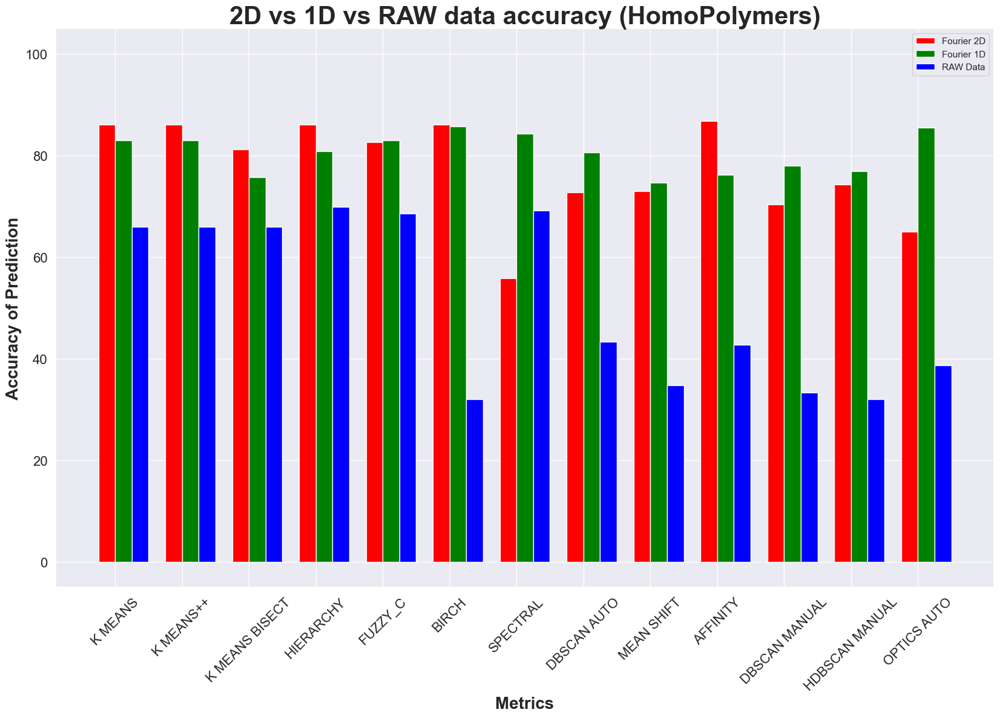

In [47]:

N = 13
ind = np.arange(N)
width = 0.25
fig = plt.figure(figsize=(20, 12), dpi = 100) # Size & DPI of Plot
xvals = DG_2
bar1 = plt.bar(ind, xvals, width, color = 'red')

yvals = DG_1
bar2 = plt.bar(ind+width, yvals, width, color='green')

zvals = DG_R
bar3 = plt.bar(ind+width*2, zvals, width, color = 'blue')
plt.xlabel("Metrics", fontweight = 'bold', fontsize = 20)
plt.ylabel("Accuracy of Prediction",fontweight='bold',fontsize = 20)
plt.title("2D vs 1D vs RAW data accuracy (HomoPolymers)",fontweight='bold',fontsize = 30)

plt.xticks(ind + width/2, FULL_2D.index, rotation = 45, fontsize = 16)
plt.yticks(fontsize = 16)
plt.legend( (bar1, bar2, bar3), ('Fourier 2D', 'Fourier 1D', 'RAW Data') )
plt.ylim(-5,105)
plt.savefig("Accuracy Comparison",bbox_inches='tight')
plt.show()


In [42]:
# This Function performs PLotting of the Raw Data (Sample Images without Clustering) i.e. just for reference

import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
from skimage.io import imread, imshow
import math

# Presets for Plots 
sns.set(style="darkgrid")
import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 100


# The function takes 1 field of input, 
# 1. Original = the original data as attained from Reader.py

def plotter(original):
          
    rows, columns = col_calc(original)

    fig = plt.figure(figsize=(100, 95), dpi = 100) # Size & DPI of Plot
    
    # Generation of Samples plots
    for i in range(len(original)):    
        
        fig.add_subplot(rows, columns, i+1)
        
        plt.imshow(original[i], aspect = "equal", cmap = "gray")
        plt.axis('off')
        plt.title("Sample Number = "+str(i),fontsize= '60')
        plt.tight_layout()
    plt.savefig("Initial Data", bbox_inches='tight')


def col_calc(input):

    f_r = math.ceil(len(input)/10)
    f_c = math.ceil(len(input)/10)
    target = len(input)

    while target >= f_r*f_c:
        f_c = f_c+1

    return f_r,f_c    

In [43]:
#IPLOT.plotter(original)
plotter(original)

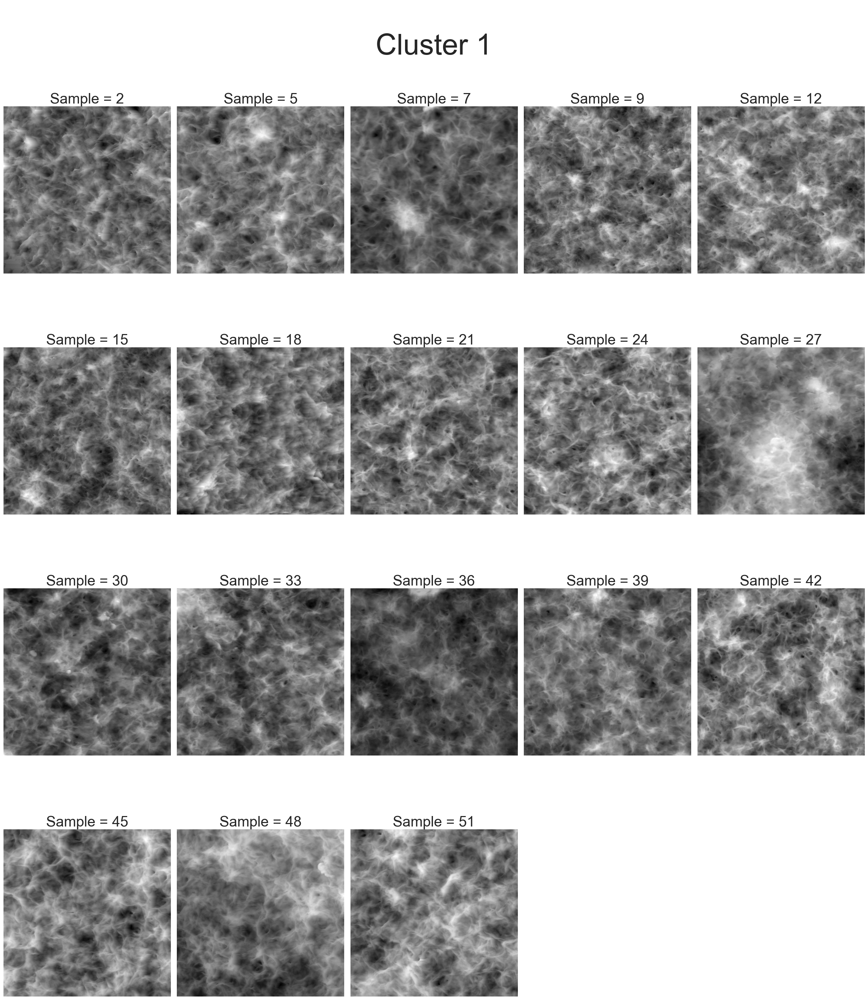

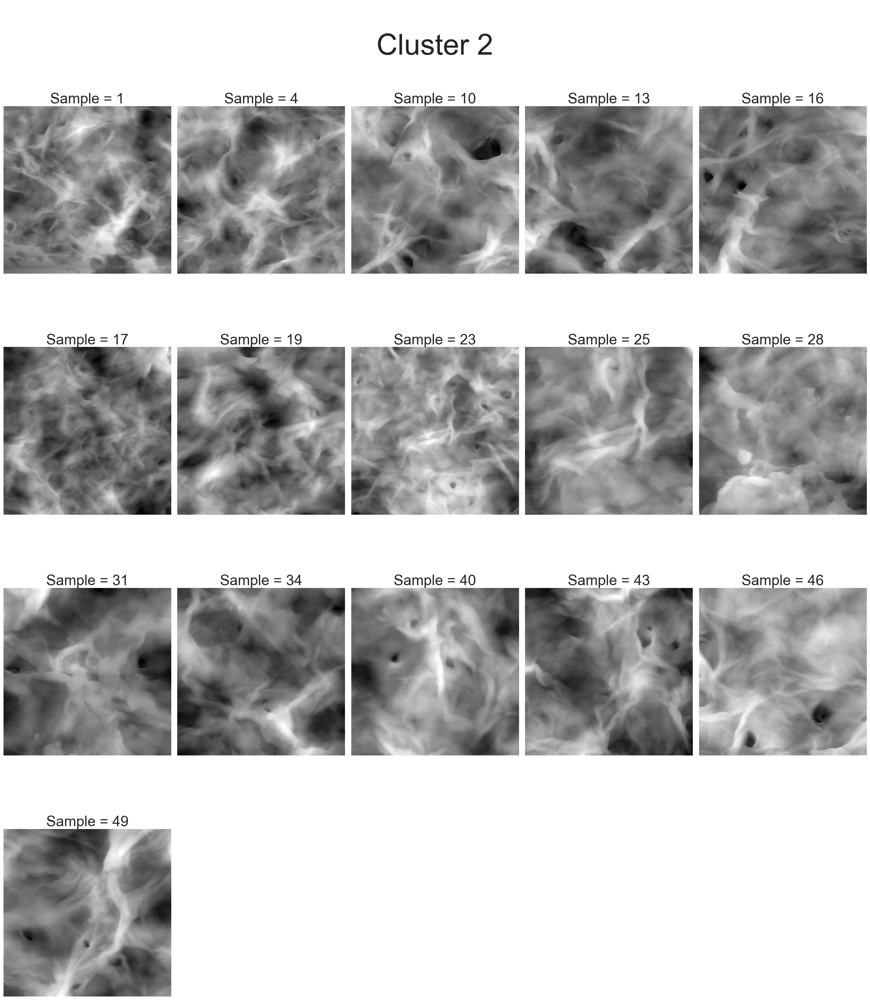

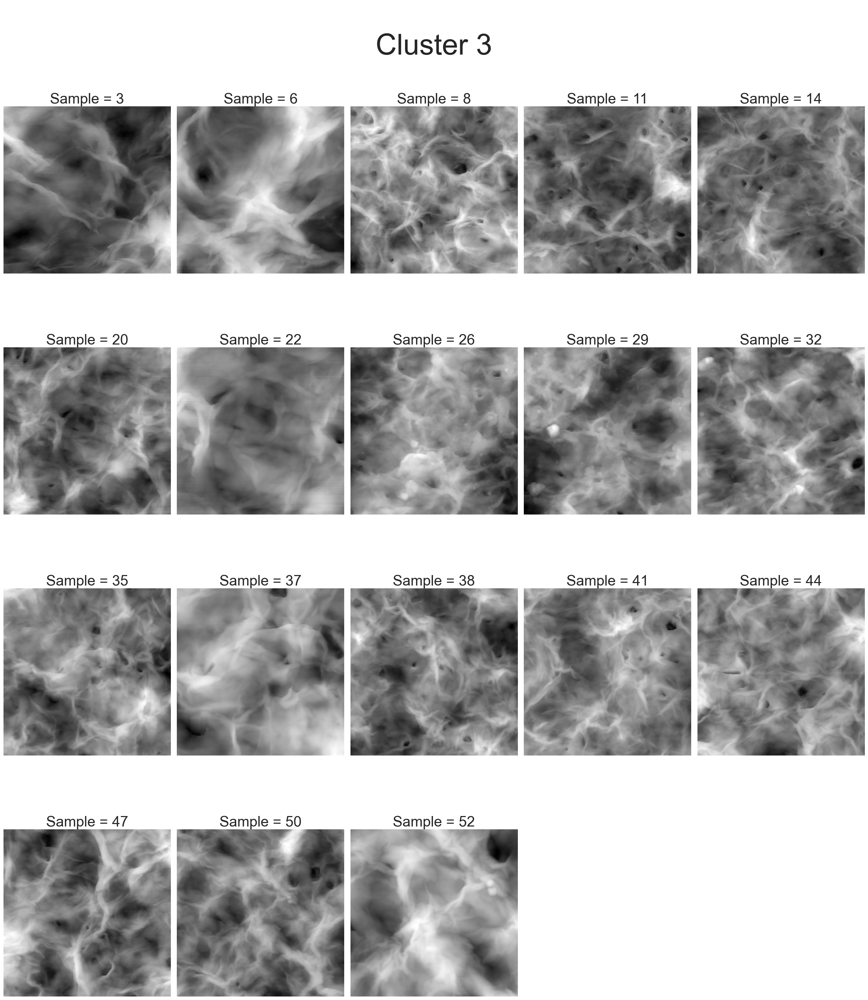

In [44]:
FPLOT.plotter_2(T2_A1_G1[0], original)

In [19]:
import seaborn as sns
from matplotlib.pyplot import figure
from skimage.io import imread, imshow

# Presets for Plots 
sns.set(style="darkgrid")
import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 100

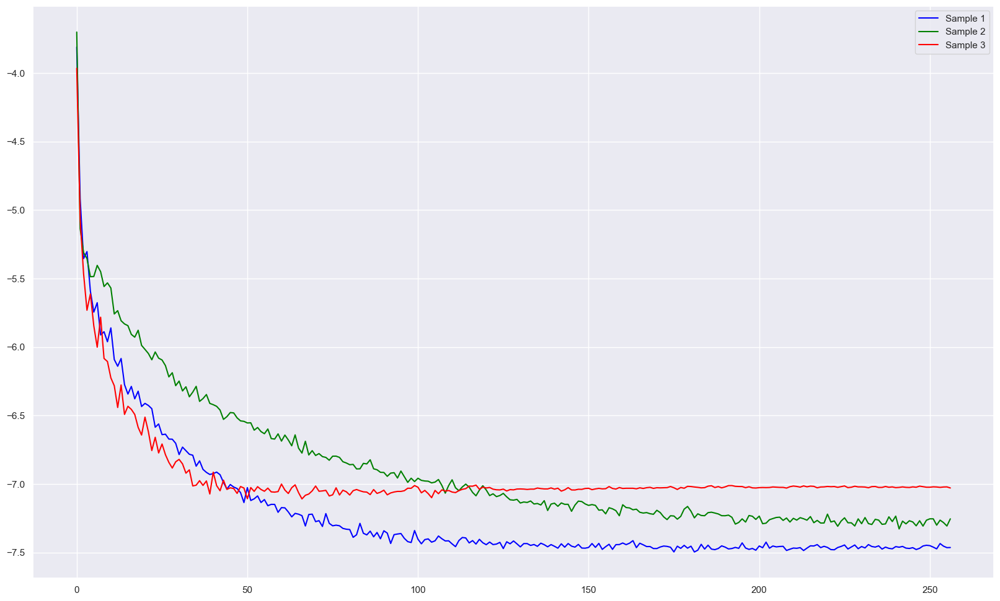

In [26]:
figure(figsize = (20,12), dpi = 100)
plt.plot(ONE_Data[1][0],c='blue', label = "Sample 1")
plt.plot(ONE_Data[1][1],c='green', label = "Sample 2")
plt.plot(ONE_Data[1][2],c='red', label = "Sample 3")
plt.legend()
plt.show()

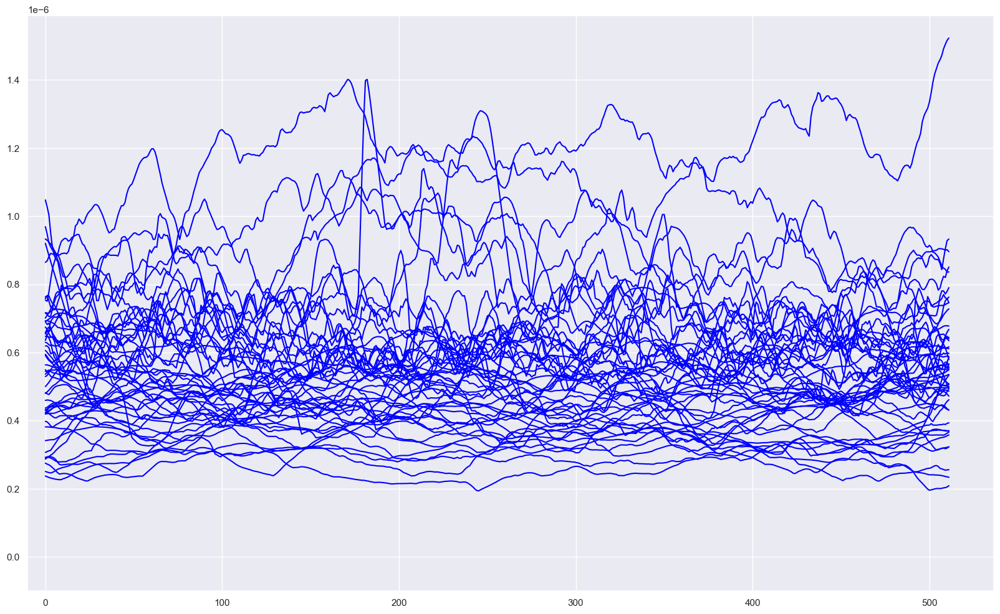

In [60]:

figure(figsize = (20,12), dpi = 100)
plt.plot(original[1].max(),c='blue')
plt.plot(original[2].max(),c='blue')
plt.plot(original[3].max(),c='blue')
plt.plot(original[4].max(),c='blue')
plt.plot(original[5].max(),c='blue')
plt.plot(original[6].max(),c='blue')
plt.plot(original[7].max(),c='blue')
plt.plot(original[8].max(),c='blue')
plt.plot(original[9].max(),c='blue')
plt.plot(original[10].max(),c='blue')

plt.plot(original[11].max(),c='blue')
plt.plot(original[12].max(),c='blue')
plt.plot(original[13].max(),c='blue')
plt.plot(original[14].max(),c='blue')
plt.plot(original[15].max(),c='blue')
plt.plot(original[16].max(),c='blue')
plt.plot(original[17].max(),c='blue')
plt.plot(original[18].max(),c='blue')
plt.plot(original[19].max(),c='blue')
plt.plot(original[20].max(),c='blue')


plt.plot(original[21].max(),c='blue')
plt.plot(original[22].max(),c='blue')
plt.plot(original[23].max(),c='blue')
plt.plot(original[24].max(),c='blue')
plt.plot(original[25].max(),c='blue')
plt.plot(original[26].max(),c='blue')
plt.plot(original[27].max(),c='blue')
plt.plot(original[28].max(),c='blue')
plt.plot(original[29].max(),c='blue')
plt.plot(original[30].max(),c='blue')

plt.plot(original[31].max(),c='blue')
plt.plot(original[32].max(),c='blue')
plt.plot(original[33].max(),c='blue')
plt.plot(original[34].max(),c='blue')
plt.plot(original[35].max(),c='blue')
plt.plot(original[36].max(),c='blue')
plt.plot(original[37].max(),c='blue')
plt.plot(original[38].max(),c='blue')
plt.plot(original[39].max(),c='blue')
plt.plot(original[40].max(),c='blue')

plt.plot(original[41].max(),c='blue')
plt.plot(original[42].max(),c='blue')
plt.plot(original[43].max(),c='blue')
plt.plot(original[44].max(),c='blue')
plt.plot(original[45].max(),c='blue')
plt.plot(original[46].max(),c='blue')
plt.plot(original[47].max(),c='blue')
plt.plot(original[48].max(),c='blue')
plt.plot(original[49].max(),c='blue')
plt.plot(original[50].max(),c='blue')
plt.plot(original[51].max(),c='blue')



plt.xlim(-10)
plt.ylim(-0.0000001)

plt.show()


In [ ]:

figure(figsize = (20,12), dpi = 100)
plt.plot(original[1].max(),c='blue')
plt.plot(original[2].max(),c='blue')
plt.plot(original[3].max(),c='blue')
plt.plot(original[4].max(),c='blue')
plt.plot(original[5].max(),c='blue')
plt.plot(original[6].max(),c='blue')
plt.plot(original[7].max(),c='blue')
plt.plot(original[8].max(),c='blue')
plt.plot(original[9].max(),c='blue')
plt.plot(original[10].max(),c='blue')

plt.plot(original[11].max(),c='blue')
plt.plot(original[12].max(),c='blue')
plt.plot(original[13].max(),c='blue')
plt.plot(original[14].max(),c='blue')
plt.plot(original[15].max(),c='blue')
plt.plot(original[16].max(),c='blue')
plt.plot(original[17].max(),c='blue')
plt.plot(original[18].max(),c='blue')
plt.plot(original[19].max(),c='blue')
plt.plot(original[20].max(),c='blue')


plt.plot(original[21].max(),c='blue')
plt.plot(original[22].max(),c='blue')
plt.plot(original[23].max(),c='blue')
plt.plot(original[24].max(),c='blue')
plt.plot(original[25].max(),c='blue')
plt.plot(original[26].max(),c='blue')
plt.plot(original[27].max(),c='blue')
plt.plot(original[28].max(),c='blue')
plt.plot(original[29].max(),c='blue')
plt.plot(original[30].max(),c='blue')

plt.plot(original[31].max(),c='blue')
plt.plot(original[32].max(),c='blue')
plt.plot(original[33].max(),c='blue')
plt.plot(original[34].max(),c='blue')
plt.plot(original[35].max(),c='blue')
plt.plot(original[36].max(),c='blue')
plt.plot(original[37].max(),c='blue')
plt.plot(original[38].max(),c='blue')
plt.plot(original[39].max(),c='blue')
plt.plot(original[40].max(),c='blue')

plt.plot(original[41].max(),c='blue')
plt.plot(original[42].max(),c='blue')
plt.plot(original[43].max(),c='blue')
plt.plot(original[44].max(),c='blue')
plt.plot(original[45].max(),c='blue')
plt.plot(original[46].max(),c='blue')
plt.plot(original[47].max(),c='blue')
plt.plot(original[48].max(),c='blue')
plt.plot(original[49].max(),c='blue')
plt.plot(original[50].max(),c='blue')
plt.plot(original[51].max(),c='blue')



plt.xlim(-10)
plt.ylim(-0.0000001)

plt.show()


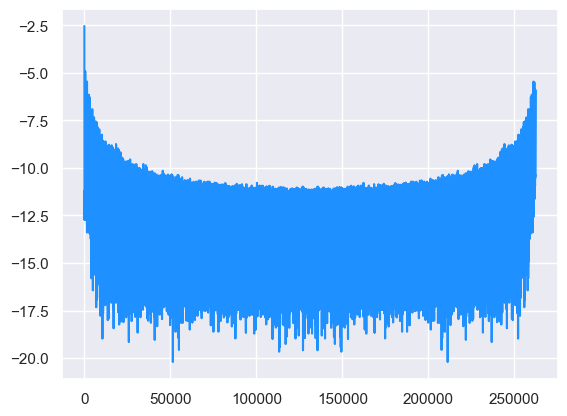

In [30]:
plt.plot(TWO_Data[0], c= "dodgerblue")


In [65]:
SS = pd.read_csv("Y:\Gihub Repo Work\Poly_Clust\\2D_OUTPUT.csv")

In [66]:
SS

,Unnamed: 0,Similarity,Cluster Accuracy,Gmean of Precision & Recall,Cluster Independence,Variance Ration of Cluster,Cluster Seperation
0,K MEANS,75.690000,73.27,79.14,0.23,31.83,1.41
1,K MEANS++,75.690000,73.27,79.14,0.23,31.83,1.41
2,K MEANS BISECT,67.100000,63.95,71.57,0.22,30.30,1.55
3,HIERARCHY,75.690000,73.27,79.14,0.23,31.83,1.41
4,FUZZY_C,66.953333,59.49,73.07,0.21,30.92,1.54
5,BIRCH,75.690000,73.27,79.14,0.23,31.83,1.41
6,SPECTRAL,17.853333,2.65,31.26,-0.04,0.85,7.67
7,DBSCAN AUTO,56.860000,59.54,63.28,0.09,13.07,2.34
8,MEAN SHIFT,56.970000,54.57,67.99,0.17,24.02,0.91
9,AFFINITY,76.653333,73.82,80.07,0.23,31.27,1.46


0     75.690000
1     75.690000
2     67.100000
3     75.690000
4     66.953333
5     75.690000
6     17.853333
7     56.860000
8     56.970000
9     76.653333
10    48.406667
11    62.840000
12    40.050000
Name: Similarity, dtype: float64

In [81]:
DG_2 = SS["Unnamed: 0"]

In [77]:
N = 13
ind = np.arange(N)
width = 0.25
fig = plt.figure(figsize=(20, 12), dpi = 100) # Size & DPI of Plot
xvals = SS["Similarity"]
bar1 = plt.bar(ind, xvals, width, color = 'r')

plt.xlabel("Metrics")
plt.ylabel("Accuracy of Prediction",fontweight='bold',fontsize = 30)
plt.title("2D vs 1D vs RAW data accuracy",fontweight='bold',fontsize = 30)

plt.xticks(r + width/2, FULL_2D.index, rotation = 45, fontsize = 20)
plt.legend( (bar1, bar2, bar3), ('Fourier 2D', 'Fourier 1D', 'RAW Data') )
plt.ylim(-5,105)
plt.show()

NameError: name 'DG_2' is not defined

<Figure size 2000x1200 with 0 Axes>